# SWEN 711 - Spring 24 - Term Project

### Code written by: Hemanth Chebiyam, Sanjeev Vijayakumar

### DQN Algorithm on OpenAI Gym Car Racing Environment

In [2]:
%%capture

!pip install stable-baselines3 gymnasium[all]

In [3]:
pip install swig

  Using cached swig-4.2.1-py2.py3-none-manylinux_2_5_x86_64.manylinux1_x86_64.whl (1.9 MB)


In [4]:
pip install gymnasium[box2d]

  Using cached gymnasium-0.29.1-py3-none-any.whl (953 kB)
  Using cached Farama_Notifications-0.0.4-py3-none-any.whl (2.5 kB)
  Using cached box2d-py-2.3.5.tar.gz (374 kB)
  Preparing metadata (setup.py) ... done
  Created wheel for box2d-py: filename=box2d_py-2.3.5-cp310-cp310-linux_x86_64.whl size=2376097 sha256=a127863863dd19a28339e46b9a374da0ea10553491bc50dee397c0f0e3586e76
  Stored in directory: /root/.cache/pip/wheels/db/8f/6a/eaaadf056fba10a98d986f6dce954e6201ba3126926fc5ad9e
Successfully built box2d-py


In [5]:
pip install stable_baselines3

  Using cached stable_baselines3-2.3.2-py3-none-any.whl (182 kB)
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.19.3-py3-none-manylinux1_x86_64.whl (166.0 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-manylinux1_x86_64.whl

In [7]:
import gymnasium as gym
env = gym.make("CarRacing-v2", domain_randomize=True, continuous=False)

print("Action Space:", env.action_space)

# Note, in the output Observation Space Box(0, 255, (96, 96, 3), uint8),
# 0 and 255 represent the lower and upper limit of the numbers in that
# (96, 96, 3) array.
print("Observation Space: ", env.observation_space)

print("Env Spec: ", env.spec)

Action Space: Discrete(5)
Observation Space:  Box(0, 255, (96, 96, 3), uint8)
Env Spec:  EnvSpec(id='CarRacing-v2', entry_point='gymnasium.envs.box2d.car_racing:CarRacing', reward_threshold=900, nondeterministic=False, max_episode_steps=1000, order_enforce=True, autoreset=False, disable_env_checker=False, apply_api_compatibility=False, kwargs={'domain_randomize': True, 'continuous': False}, namespace=None, name='CarRacing', version=2)


In [8]:
import gymnasium as gym

# First, we create our environment called CarRacing-v2.
env = gym.make("CarRacing-v2", domain_randomize=True, continuous=False)

# Then we reset this environment
observation, info = env.reset()

for _ in range(10):
    # Take a random action from the action space.
    action = env.action_space.sample()

    # Do this action in the environment and get
    # next_state, reward, terminated, truncated and info
    observation, reward, terminated, truncated, info = env.step(action)
    print(f"Action taken: {action}, reward: {reward}.")

    # If the game is terminated (in our case we land, crashed) or truncated (timeout),
    # reset the environment.
    if terminated or truncated:
        # Reset the environment
        print("Environment is reset")
        observation, info = env.reset()

env.close()

Action taken: 1, reward: 7.199270072992701.
Action taken: 2, reward: -0.09999999999999964.
Action taken: 3, reward: -0.09999999999999964.
Action taken: 4, reward: -0.09999999999999964.
Action taken: 0, reward: -0.09999999999999964.
Action taken: 3, reward: -0.09999999999999964.
Action taken: 0, reward: -0.09999999999999964.
Action taken: 1, reward: -0.09999999999999964.
Action taken: 1, reward: -0.09999999999999964.
Action taken: 2, reward: -0.09999999999999964.


In [9]:
import gymnasium as gym
from stable_baselines3 import DQN
from stable_baselines3.common.callbacks import EvalCallback

In [10]:
from typing import Callable

# In our experiments, using a linear schedule that gradually decreases the
# learning rate achieved better performance than using a fixed learning rate.
def linear_schedule(initial_value: float) -> Callable[[float], float]:
    """
    Linear learning rate schedule.

    :param initial_value: Initial learning rate.
    :return: schedule that computes
      current learning rate depending on remaining progress
    """
    def func(progress_remaining: float) -> float:
        """
        Progress will decrease from 1 (beginning) to 0.

        :param progress_remaining:
        :return: current learning rate
        """
        return progress_remaining * initial_value

    return func

In [ ]:
import os

env = gym.make("CarRacing-v2", domain_randomize=True, continuous=False)

# Set seed for reproducibility.
env.reset(seed=1234)
env.action_space.seed(123)

# Instantiate the agent and specify the directory for Tensorboard log.
# With Tensorboard log, we can monitor the model training progress.
model = DQN('CnnPolicy', env, verbose=1, device="cuda", learning_rate=linear_schedule(0.0001), tensorboard_log="./dqn_carrace_tensorboard_lr0001_1e7/")
# Specify the directory to save the best model.
dnq_path = os.path.join('./Saved_Models/dqn_best_model_lr0001_1e7')

# EvalCallback evaluates periodically the performance of an agent, using
# a separate test environment. It will save the best model if
# best_model_save_path folder is specified.
eval_env = model.get_env()
eval_callback = EvalCallback(eval_env=eval_env, best_model_save_path=dnq_path,
                             n_eval_episodes=50,
                             eval_freq=100000,verbose=1,
                             deterministic=True, render=False)

# Train the agent.
model.learn(total_timesteps=1000000,callback=eval_callback)

# Specify the path to save the final model.
final_path = os.path.join('./Saved_Models/dqn_final_model_lr0001_1e7')
model.save(final_path)

In [ ]:
%%capture
# Install the dependecies with the following commands. If you have ffmpeg you may skip this step.
!sudo apt update -y && sudo apt upgrade -y
!sudo apt install ffmpeg -y

In [11]:
import gymnasium as gym
from matplotlib import rcParams
from matplotlib import pyplot as plt, animation
from IPython.display import HTML
from stable_baselines3 import DQN
rcParams['animation.embed_limit'] = 2**128

# Define some utility functions for generating and saving the cartoons.
def create_anim(frames, dpi, fps):
    plt.figure(figsize=(frames[0].shape[1] / dpi, frames[0].shape[0] / dpi), dpi=dpi)
    patch = plt.imshow(frames[0])
    def setup():
        plt.axis('off')
    def animate(i):
        patch.set_data(frames[i])
    anim = animation.FuncAnimation(plt.gcf(), animate, init_func=setup, frames=len(frames), interval=fps)
    return anim

def display_anim(frames, dpi=72, fps=60):
    anim = create_anim(frames, dpi, fps)
    return anim.to_jshtml()

def save_anim(frames, filename, dpi=72, fps=50):
    anim = create_anim(frames, dpi, fps)
    anim.save(filename)

In [12]:
env = gym.make("CarRacing-v2", domain_randomize=True, continuous=False, render_mode='rgb_array')

# Generate observations of one episode with random actions.
frames = []
episodes = 1

for episode in range(1, episodes+1):
    state = env.reset()
    terminated = truncated = False
    score = 0

    while not (terminated or truncated):
        frames.append(env.render())
        # Note: here we are randomly sampling an action.
        action = env.action_space.sample()
        observation, reward, terminated, truncated, info = env.step(action)
        score += reward
    # Print out the number of episodes and accumulated rewards at the end of the episode.
    print("Episode:{} Score:{}".format(episode,score))
env.close()

Episode:1 Score:-50.1779359430613


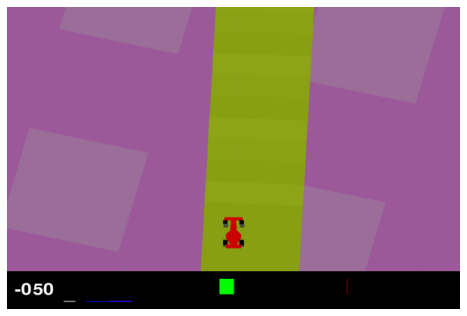

In [13]:
# Display the cartoon inline. This agent takes random actions.
# Due to the size of the video is too large, we removed the output.
# You can refer to the 'videos' folder to see the generated video
# saved with the step listed below.
HTML(display_anim(frames))

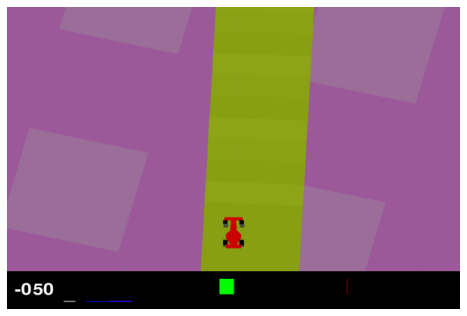

In [14]:
# Action in the cartoon is based on random action.
# Save the cartoon. We provided the generated cartoon in the /videos folder.
filename = 'CarRacing-v2_random.mp4'
save_anim(frames, filename=filename)

In [ ]:
# Load the best model based on evaluation. You may need to change the model
# path depending on where your best model is stored.
model_path = "./Saved_Models/dqn_best_model_lr0001_1e7/best_model"
model = DQN.load(model_path, env=env)

Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
Wrapping the env in a VecTransposeImage.


/usr/local/lib/python3.10/dist-packages/stable_baselines3/common/buffers.py:241: UserWarning: This system does not have apparently enough memory to store the complete replay buffer 55.31GB > 10.80GB
  warnings.warn(


In [ ]:
# Generate observations of one episode with actions predicted by the best model.

frames = []
episodes = 1

for episode in range(1, episodes+1):
    observation, _ = env.reset()
    terminated = truncated = False
    score = 0

    while not (terminated or truncated):
        frames.append(env.render())
        action , _ = model.predict(observation)
        observation, reward, terminated, truncated, info = env.step(action)
        score += reward
    print("Episode:{} Score:{}".format(episode,score))
env.close()

Episode:1 Score:-50.43731778425745


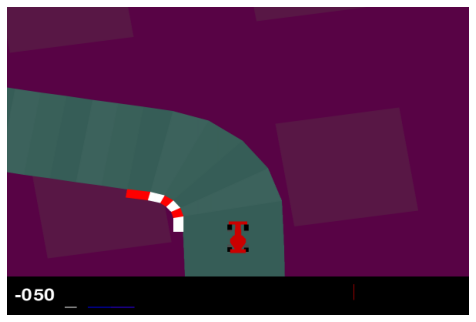

In [ ]:
# Display the cartoon inline. This agent takes random actions.
# Due to the size of the video is too large, we removed the output.
# You can refer to the 'videos' folder to see the generated video
# saved with the step listed below.
HTML(display_anim(frames))

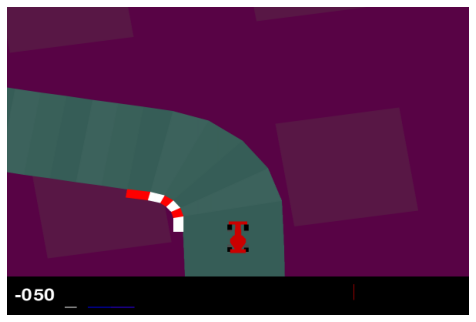

In [ ]:
# Action in the cartoon was selected using the trained best model.
# Save the cartoon. We provided the generated cartoon in the /videos folder.
filename = 'CarRacing-v2_best.mp4'
save_anim(frames, filename=filename)